# Convert mp4/avi to wav 

In [3]:
!dir

 C 드라이브의 볼륨에는 이름이 없습니다.
 볼륨 일련 번호: 9642-EB45

 C:\Users\jason\OneDrive\Desktop\jupyter\audio 디렉터리

2021-01-13  오후 04:21    <DIR>          .
2021-01-13  오후 04:21    <DIR>          ..
2021-01-13  오후 04:21    <DIR>          .ipynb_checkpoints
2021-01-13  오후 04:10    <DIR>          audio_data
2021-01-07  오후 04:45            97,248 audio_normalize.ipynb
2021-01-13  오후 04:21        36,227,403 BB_filtering.ipynb
               2개 파일          36,324,651 바이트
               4개 디렉터리  140,582,551,552 바이트 남음


In [2]:
import os

# Root = "audio_data/"
filename = "BB_hibb_noisy_left.avi"
destination = "BB_hibb_noisy_left_converted"
os.chdir('C://Users/jason/OneDrive/Desktop/jupyter/audio_data')
print(os.getcwd())
# ffmpeg 설정이 필수
os.system('ffmpeg -i {} -f wav -ab 16000 -vn {}.wav'.format(filename, destination))

C:\Users\jason\OneDrive\Desktop\jupyter\audio_data


1

# Overlay sounds

In [3]:
!dir

 C 드라이브의 볼륨에는 이름이 없습니다.
 볼륨 일련 번호: 9642-EB45

 C:\Users\jason\OneDrive\Desktop\jupyter\audio_data 디렉터리

2021-01-13  오전 11:35    <DIR>          .
2021-01-13  오전 11:35    <DIR>          ..
2021-01-06  오후 06:00            32,044 Arduino_Small.wav
2021-01-07  오후 04:17            32,044 Arduino_Small_Normalized.wav
2021-01-11  오후 05:25         7,561,324 BB_hibb_noisy.mp4
2021-01-12  오후 01:36         7,573,400 BB_hibb_noisy2.mp4
2021-01-11  오후 04:34        28,365,940 BB_hibb_noisy_left.AVI
2021-01-13  오전 09:40         5,402,702 BB_hibb_noisy_left_converted.wav
2021-01-12  오후 01:44        28,517,662 BB_hibb_silenced.AVI
2021-01-12  오후 02:16        28,573,598 BB_music_only_close.AVI
2021-01-12  오후 02:17        21,183,658 BB_music_only_far.AVI
2021-01-12  오후 01:20         5,402,702 converted_wave.wav
2021-01-12  오후 01:37         5,398,606 converted_wave2.wav
2021-01-06  오후 06:00            32,044 Mobile_Large.wav
2021-01-07  오후 04:17            32,044 Mobile_Large_Normalized.wav
2021-01-12  오후 

In [4]:
from pydub import AudioSegment
sound1 = AudioSegment.from_file("music_only_far_converted.wav", format="wav")
sound2 = AudioSegment.from_file("silenced_converted.wav", format="wav")

# sound1 6 dB louder
# louder = sound1 + 6

# Overlay sound2 over sound1 at position 0  (use louder instead of sound1 to use the louder version)
overlay = sound1.overlay(sound2, position=0)


# simple export
file_handle = overlay.export("overlayed_with_music_far.wav", format="wav")

# Compare Sounds 

In [5]:
!pip install IPython

In [6]:
import IPython.display as ipd
from IPython.display import Audio

ipd.display(Audio("overlayed_with_music.wav"))
ipd.display(Audio("BB_hibb_noisy_left_converted.wav"))

# Plot waves 

Just mono files
[ -78  -78 -119 -122 -157 -159 -191 -193 -214 -217]
Just mono files
[-893 -897 -869 -876 -809 -817 -716 -722 -588 -593]
Just mono files
[-815 -819 -750 -754 -652 -658 -525 -529 -374 -376]
Just mono files
[70 71 72 72 64 66 49 50 55 56]


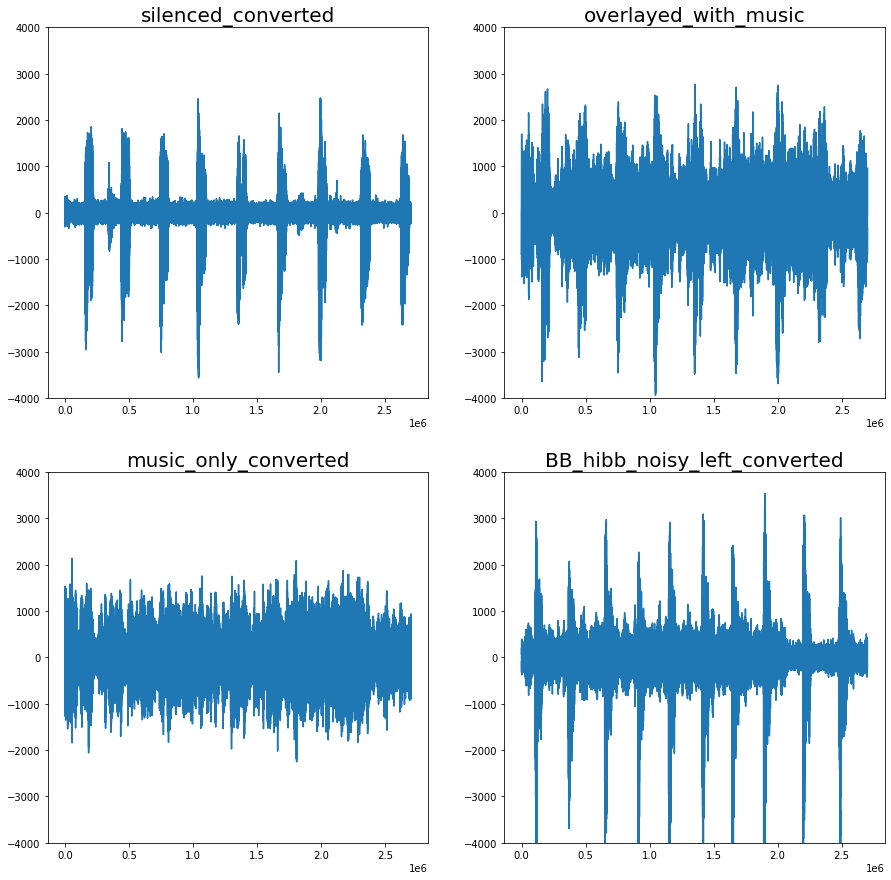

In [43]:
import matplotlib.pyplot as plt
import numpy as np
import wave
import sys
import os
import IPython.display as ipd
from scipy.io import wavfile

file_name1 = 'silenced_converted'
file_name2 = 'overlayed_with_music'
file_name3 = 'music_only_converted'
file_name4 = 'BB_hibb_noisy_left_converted'

fig = plt.figure(figsize=(15,15))

def plot_wav(file_name, index):
    spf = wave.open(file_name + '.wav', "r")

    # Extract Raw Audio from Wav File

    # n frames of audio to bytes where n = -1
    signal = spf.readframes(-1)

    # A new 1-D array initialized from text data in a string
    signal = np.frombuffer(signal, "int16")
    # print(signal)

    # getnchannel = 1 => mono  /  getnchannel = 2 => stereo
    if spf.getnchannels() == 2:
        print("Just mono files")
#         sys.exit(0)

    global fig
    subplt = plt.subplot(2, 2, index)
    # ax = fig.add_subplot(111)
    subplt.set_ylim(-4000,4000)

    subplt.spines['bottom'].set_color('black')
    subplt.tick_params(axis='x', colors='black')
    # y = fig.add_subplot(111)
    subplt.spines['left'].set_color('black')
    subplt.tick_params(axis='y', colors='black')

    plt.title(file_name, fontdict={'fontsize': 20, 'color': 'black'})
    plt.plot(signal)
    print(signal[:10])
    fig.add_subplot(subplt)
  # plt.show()


plot_wav(file_name1, 1)
plot_wav(file_name2, 2)
plot_wav(file_name3, 3)
plot_wav(file_name4, 4)

plt.show()

# Overlaying same audio

In [8]:
!dir

 C 드라이브의 볼륨에는 이름이 없습니다.
 볼륨 일련 번호: 9642-EB45

 C:\Users\jason\OneDrive\Desktop\jupyter\audio_data 디렉터리

2021-01-13  오전 11:35    <DIR>          .
2021-01-13  오전 11:35    <DIR>          ..
2021-01-06  오후 06:00            32,044 Arduino_Small.wav
2021-01-07  오후 04:17            32,044 Arduino_Small_Normalized.wav
2021-01-11  오후 05:25         7,561,324 BB_hibb_noisy.mp4
2021-01-12  오후 01:36         7,573,400 BB_hibb_noisy2.mp4
2021-01-11  오후 04:34        28,365,940 BB_hibb_noisy_left.AVI
2021-01-13  오전 09:40         5,402,702 BB_hibb_noisy_left_converted.wav
2021-01-12  오후 01:44        28,517,662 BB_hibb_silenced.AVI
2021-01-12  오후 02:16        28,573,598 BB_music_only_close.AVI
2021-01-12  오후 02:17        21,183,658 BB_music_only_far.AVI
2021-01-12  오후 01:20         5,402,702 converted_wave.wav
2021-01-12  오후 01:37         5,398,606 converted_wave2.wav
2021-01-06  오후 06:00            32,044 Mobile_Large.wav
2021-01-07  오후 04:17            32,044 Mobile_Large_Normalized.wav
2021-01-12  오후 

In [22]:
from pydub import AudioSegment
sound1 = AudioSegment.from_file("music_only_converted.wav", format="wav")
overlayed = sound1
# sound2 = AudioSegment.from_file("silenced_converted.wav", format="wav")

# sound1 6 dB louder
# louder = sound1 + 6

# Overlay sound2 over sound1 at position 0  (use louder instead of sound1 to use the louder version)

for i in range(4):
    global overlayed
    overlayed = overlayed.overlay(sound1, position=0)


# simple export
file_handle = overlayed.export("music_only_converted_overlayed5.wav", format="wav")

[[-815 -819]
 [-750 -754]
 [-652 -658]
 [-525 -529]
 [-374 -376]
 [-223 -228]
 [-106 -106]
 [  -6   -5]
 [  14   13]
 [  39   39]]
[[-1630 -1638]
 [-1500 -1508]
 [-1304 -1316]
 [-1050 -1058]
 [ -748  -752]
 [ -446  -456]
 [ -212  -212]
 [  -12   -10]
 [   28    26]
 [   78    78]]
[[-4075 -4095]
 [-3750 -3770]
 [-3260 -3290]
 [-2625 -2645]
 [-1870 -1880]
 [-1115 -1140]
 [ -530  -530]
 [  -30   -25]
 [   70    65]
 [  195   195]]


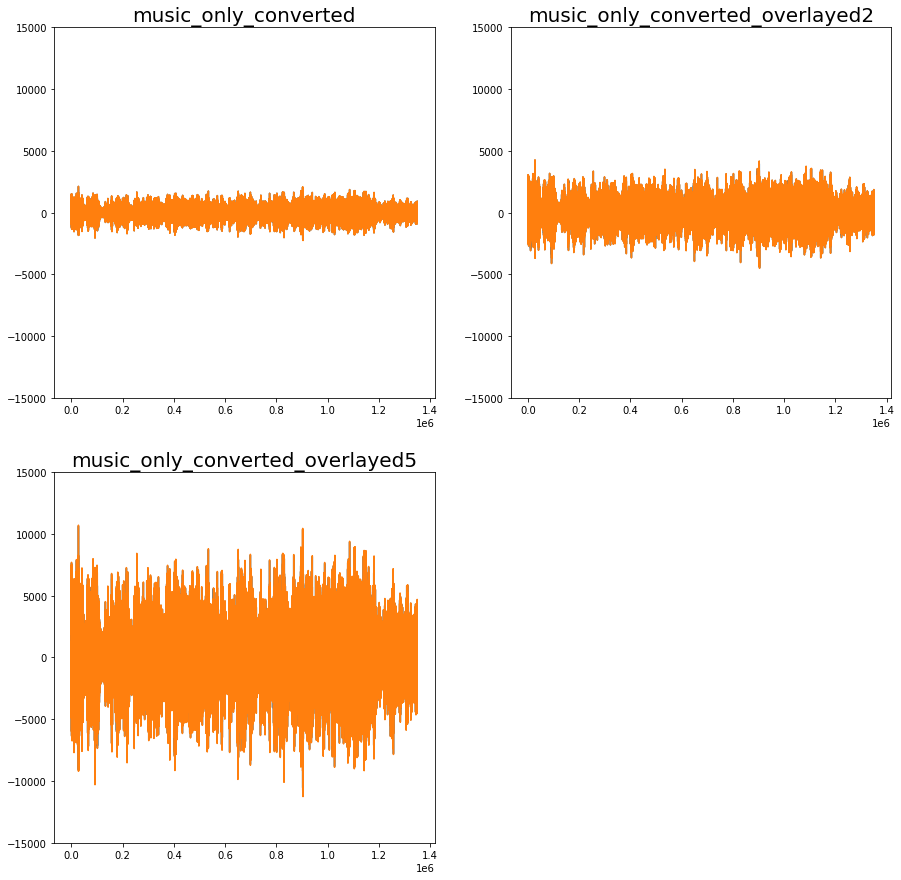

In [39]:
import matplotlib.pyplot as plt
import numpy as np
import wave
import sys
import os
import IPython.display as ipd
from scipy.io import wavfile
from IPython.display import Audio

file_name1 = 'music_only_converted'
file_name2 = 'music_only_converted_overlayed2'
file_name3 = 'music_only_converted_overlayed5'

fig = plt.figure(figsize=(15,15))

def plot_wav(file_name, index):
    samplerate, data = wavfile.read(file_name + '.wav')

    global fig
    subplt = plt.subplot(2, 2, index)
    # ax = fig.add_subplot(111)
    subplt.set_ylim(-15000,15000)

    subplt.spines['bottom'].set_color('black')
    subplt.tick_params(axis='x', colors='black')
    # y = fig.add_subplot(111)`
    subplt.spines['left'].set_color('black')
    subplt.tick_params(axis='y', colors='black')

    plt.title(file_name, fontdict={'fontsize': 20, 'color': 'black'})
    plt.plot(data)
    print(data[:10])
    fig.add_subplot(subplt)
  # plt.show()

ipd.display(Audio(file_name1 + ".wav"))
ipd.display(Audio(file_name2 + ".wav"))
ipd.display(Audio(file_name3 + ".wav"))

plot_wav(file_name1, 1)
plot_wav(file_name2, 2)
plot_wav(file_name3, 3)

plt.show()



# 배열에 곱셈을해서 wav file 만들기 

[[-446.5 -448.5]
 [-434.5 -438. ]
 [-404.5 -408.5]
 [-358.  -361. ]
 [-294.  -296.5]
 [-227.  -231. ]
 [-173.5 -174.5]
 [-131.5 -132. ]
 [-117.5 -119.5]
 [-106.  -108. ]]
[[ -78  -78]
 [-119 -122]
 [-157 -159]
 [-191 -193]
 [-214 -217]
 [-231 -234]
 [-241 -243]
 [-257 -259]
 [-249 -252]
 [-251 -255]]
[[-815 -819]
 [-750 -754]
 [-652 -658]
 [-525 -529]
 [-374 -376]
 [-223 -228]
 [-106 -106]
 [  -6   -5]
 [  14   13]
 [  39   39]]


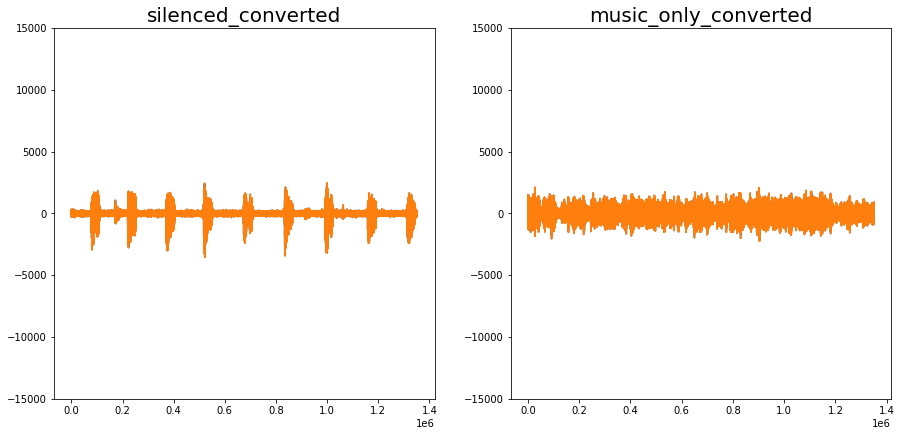

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import wave
import sys
import os
import IPython.display as ipd
from scipy.io import wavfile

file_name1 = 'silenced_converted'
file_name2 = 'music_only_converted'

fig = plt.figure(figsize=(15,15))

def wav_scale(file_name,  multiplier):
    samplerate, data = wavfile.read(file_name1 + '.wav')
    
    scaled_data = data * multiplier
    print(scaled_data[:10])
    
    wavfile.write(file_name1 + '_scaled{}.wav'.format(multiplier), samplerate, scaled_data.astype(np.int16))
    

def sum_wave(file_name1, file_name2, multiplier):
    samplerate1, data1 = wavfile.read(file_name1 + '.wav')
    samplerate2, data2 = wavfile.read(file_name2 + '.wav')
    
    scaled_data1 = data1 * multiplier
    scaled_data2 = data2 * multiplier
    
    min_length = min(len(scaled_data1), len(scaled_data2))
    
    
    scaled_data = scaled_data1[:min_length] + scaled_data2[:min_length]
    print(scaled_data[:10])
    
    wavfile.write("sum_wave" + '_scaled{}.wav'.format(multiplier), samplerate1, scaled_data.astype(np.int16))

def plot_wav(file_name, index):
    
    samplerate, data = wavfile.read(file_name + '.wav')
    


    global fig
    subplt = plt.subplot(2, 2, index)
    # ax = fig.add_subplot(111)
    subplt.set_ylim(-15000,15000)

    subplt.spines['bottom'].set_color('black')
    subplt.tick_params(axis='x', colors='black')
    # y = fig.add_subplot(111)
    subplt.spines['left'].set_color('black')
    subplt.tick_params(axis='y', colors='black')

    plt.title(file_name, fontdict={'fontsize': 20, 'color': 'black'})
    plt.plot(data)
    print(data[:10])
    fig.add_subplot(subplt)
  # plt.show()

# wav_scale(file_name1, 0.5)
# wav_scale(file_name1, 0.5)
sum_wave(file_name1, file_name2, 0.5)

plot_wav(file_name1, 1)
plot_wav(file_name2, 2)

# plot_wav(file_name3, 3)

plt.show()